In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image
from torch.optim.lr_scheduler import StepLR
import torch.nn as nn
import torch.nn.init as init
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score
import torchvision.models as models
from torchvision.models import ResNet50_Weights

In [ ]:
from torch.utils.data import Dataset
import os
from PIL import Image

class PairedDataset(Dataset):
    def __init__(self, root_dir, paired_root_dir=None, transform=None, max_images_per_category=None):
        self.root_dir = root_dir
        self.paired_root_dir = paired_root_dir if paired_root_dir is not None else root_dir
        self.transform = transform
        self.categories =['Earthquake', 'Flood', 'Hurricane', 'Landslides', 'Wildfire']
        self.label_map = {category: i for i, category in enumerate(self.categories)}
        #self.label_map = {'Hurricane':2,'Landslides':3}
        self.image_names = []
        self.labels = []
        self.paired_image_names = []

        for category in self.categories:
            category_dir = os.path.join(root_dir, category)
            paired_category_dir = os.path.join(self.paired_root_dir, f"{category}_paired")

            images = os.listdir(category_dir)
            paired_images = os.listdir(paired_category_dir) if os.path.exists(paired_category_dir) else []

            if max_images_per_category is not None:
                images = images[:max_images_per_category]
                paired_images = paired_images[:max_images_per_category]

            self.image_names.extend([os.path.join(category, img) for img in images])
            self.paired_image_names.extend([os.path.join(f"{category}_paired", img) for img in paired_images])
            self.labels.extend([self.label_map[category]] * len(images))

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_names[idx])
        paired_img_path = os.path.join(self.paired_root_dir, self.paired_image_names[idx])
        labels = self.labels[idx]

        image = Image.open(img_path).convert('RGB')
        paired_image = Image.open(paired_img_path).convert('RGB') if os.path.exists(paired_img_path) else None

        if self.transform:
            image = self.transform(image)
            if paired_image:
                paired_image = self.transform(paired_image)

        return image, paired_image, labels

In [ ]:
transform_normalized = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.5 for _ in range(3)], [0.5 for _ in range(3)]),
])

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

train_dataset = PairedDataset('./train+val/train', transform=transform_normalized)
val_dataset = PairedDataset('./train+val/validation', transform=transform ,max_images_per_category=50 )

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=True)

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(6, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, img, cond):
        combined = torch.cat([img, cond], 1)
        return self.main(combined)


In [ ]:
def weights_init_xavier(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear) or isinstance(m, nn.ConvTranspose2d):
        init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            init.constant_(m.bias.data, 0.0)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
model_inpainting = Generator().to(device)
D = Discriminator().to(device)
# Assuming G and D are your Generator and Discriminator models
model_inpainting.apply(weights_init_xavier)
D.apply(weights_init_xavier)

print(model_inpainting)
print(D)

total_parameters_generator = sum(p.numel() for p in model_inpainting.parameters())
total_parameters_discriminator = sum(p.numel() for p in D.parameters())

print(f"Total number of parameters in the Generator: {total_parameters_generator}")
print(f"Total number of parameters in the Discriminator: {total_parameters_discriminator}")

cpu
Generator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(64, eps=1e-05, momentum=

In [ ]:
criterion = nn.BCELoss()
criterion_L1 = nn.L1Loss()

optimizer_G = optim.Adam(model_inpainting.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))

epochs = 20
real_label = 1
fake_label = 0

In [ ]:
scheduler_G = StepLR(optimizer_G, step_size=172, gamma=0.5)
scheduler_D = StepLR(optimizer_D, step_size=172, gamma=0.5)

In [ ]:
# Path to save the checkpoints
checkpoint_dir = './checkpoints'
if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)

# Function to save a checkpoint
def save_checkpoint(state, filename="checkpoint.pth.tar"):
    torch.save(state, os.path.join(checkpoint_dir, filename))

# Function to load a checkpoint
def load_checkpoint(filename="checkpoint.pth.tar"):
    return torch.load(os.path.join(checkpoint_dir, filename))

In [ ]:
batch_size = 40

def display_images(original, corrupted, generated):
    """
    Display original, corrupted, and generated images side by side.
    Assumes all image tensors are of shape (batch, channels, height, width).
    """
    fig, axes = plt.subplots(batch_size, 3, figsize=(15, batch_size * 5))
    for i in range(batch_size):
        axes[i, 0].imshow(original[i].permute(1, 2, 0).detach().cpu())
        axes[i, 1].imshow(corrupted[i].permute(1, 2, 0).detach().cpu())
        axes[i, 2].imshow(generated[i].permute(1, 2, 0).detach().cpu())

        axes[i, 0].set_title('Original')
        axes[i, 1].set_title('Corrupted')
        axes[i, 2].set_title('Generated')

        # Remove axis ticks
        axes[i, 0].axis('off')
        axes[i, 1].axis('off')
        axes[i, 2].axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
def get_gradient_norm(model):
    total_norm = 0
    for p in model.parameters():
        if p.grad is not None:
            param_norm = p.grad.data.norm(2)
            total_norm += param_norm.item() ** 2
    total_norm = total_norm ** 0.5
    return total_norm

gradient_norm = get_gradient_norm(model_inpainting)
print(f"Generator Gradient Norm: {gradient_norm}")



Generator Gradient Norm: 0.0


In [ ]:
denormalize = transforms.Normalize(
    mean=[-1, -1, -1],
    std=[2, 2, 2]
)

normalize = transforms.Normalize(
    mean=[0.5, 0.5, 0.5],
    std=[0.5, 0.5, 0.5]
)

def combine_images(corrupted_imgs, generated_imgs):
    mask = (corrupted_imgs >= 0) & (corrupted_imgs <= 0.09)
    zero_mask = mask.all(dim=1, keepdim=True)
    combined_imgs = torch.where(zero_mask, generated_imgs, corrupted_imgs)
    return combined_imgs

In [ ]:
for epoch in range(epochs):
    for i ,(original_imgs, corrupted_imgs, labels) in enumerate(train_loader):
        corrupted_imgs, original_imgs = corrupted_imgs.to(device), original_imgs.to(device)

        optimizer_D.zero_grad()
        output_real = D(original_imgs, corrupted_imgs)
        real_labels = torch.full(output_real.shape, real_label, device=device).float()
        loss_real = criterion(output_real, real_labels)

        fake_imgs = model_inpainting(corrupted_imgs)
        output_fake = D(fake_imgs.detach(), corrupted_imgs)
        fake_labels = torch.full(output_fake.shape, fake_label, device=device).float()
        loss_fake = criterion(output_fake, fake_labels)

        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        optimizer_G.zero_grad()

        output_fake = D(fake_imgs, corrupted_imgs)
        loss_GAN = criterion(output_fake, real_labels)
        loss_L1 = criterion_L1(fake_imgs, original_imgs)

        loss_G = 0.5*loss_GAN + 100* loss_L1
        loss_G.backward()
        optimizer_G.step()

        scheduler_D.step()
        scheduler_G.step()

    print(f"Epoch {epoch+1}/{epochs} - Loss D: {loss_D.item():.4f}, Loss G: {loss_G.item():.4f}")
    checkpoint_filename = f"checkpoint_epoch_norm_{epoch + 1}.pth.tar"
    save_checkpoint({'epoch': epoch + 1,
        'G_state_dict': G.state_dict(),
        'D_state_dict': D.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'optimizer_D_state_dict': optimizer_D.state_dict(),}, filename=checkpoint_filename)
    # with torch.no_grad():
    #     for corrupted_imgs, original_imgs in val_loader:
    #         corrupted_imgs, original_imgs = corrupted_imgs.to(device), original_imgs.to(device)
    #         generated_imgs = model_inpainting(normalize(corrupted_imgs))
    #         generated_imgs = denormalize(generated_imgs)
    #         display_images(original_imgs, corrupted_imgs, combine_images(corrupted_imgs,generated_imgs))
    #         break

In [ ]:
checkpoint_dir = '.'

# Function to load a checkpoint
def load_checkpoint(filename="checkpoint.pth.tar"):
    return torch.load(os.path.join(checkpoint_dir, filename), map_location=torch.device('cpu') )


# Load the checkpoint
checkpoint = load_checkpoint("checkpoint_epoch_norm_20.pth.tar")

#Load the Generator and Discriminator states
model_inpainting.load_state_dict(checkpoint['G_state_dict'])
D.load_state_dict(checkpoint['D_state_dict'])

# Load the Optimizer states
optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_D_state_dict'])

# Load the epoch
epoch = checkpoint['epoch']

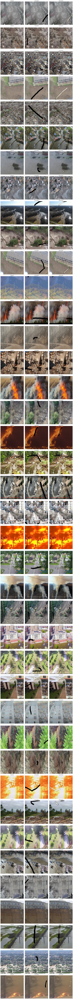

In [ ]:
with torch.no_grad():
    for original_imgs, corrupted_imgs,_ in val_loader:
        corrupted_imgs, original_imgs = corrupted_imgs.to(device), original_imgs.to(device)
        generated_imgs = model_inpainting(normalize(corrupted_imgs))
        generated_imgs = denormalize(generated_imgs)
        display_images(original_imgs, corrupted_imgs, combine_images(corrupted_imgs,generated_imgs))
        break

In [ ]:
from torchvision.utils import save_image

def display_and_save_images(original, corrupted, generated, save_dir, epoch):
    """
    Display original, corrupted, and generated images side by side.
    Save the generated images to files.
    Assumes all image tensors are of shape (batch, channels, height, width).
    """
    # Create a directory to save the generated images
    os.makedirs(save_dir, exist_ok=True)

    for i in range(len(original)):
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        # Display and save original image
        axes[0].imshow(original[i].permute(1, 2, 0).detach().cpu())
        axes[0].set_title('Original')
        axes[0].axis('off')

        # Display and save corrupted image
        axes[1].imshow(corrupted[i].permute(1, 2, 0).detach().cpu())
        axes[1].set_title('Corrupted')
        axes[1].axis('off')

        # Display and save generated image
        axes[2].imshow(generated[i].permute(1, 2, 0).detach().cpu())
        axes[2].set_title('Generated')
        axes[2].axis('off')

        # Save the generated image
        save_path = os.path.join(save_dir, f"generated_image_{epoch}_{i}.png")
        save_image(generated[i], save_path)

        plt.tight_layout()
        plt.savefig(save_path)
        plt.close()

# Example usage
save_directory = "./generated_images"
epoch_number = 20
with torch.no_grad():
    for (corrupted_imgs, original_imgs) in val_loader:
        corrupted_imgs, original_imgs = corrupted_imgs.to(device), original_imgs.to(device)
        generated_imgs = model_inpainting(normalize(corrupted_imgs))
        generated_imgs = denormalize(generated_imgs)
        display_and_save_images(original_imgs, corrupted_imgs, generated_imgs, save_directory, epoch_number)
        break


In [ ]:
# Validation loop with SSIM and PSNR
model_inpainting.eval()  # Set the generator to evaluation mode
D.eval()  # Set the discriminator to evaluation mode
ssim_scores = []
psnr_scores = []

model_inpainting = model_inpainting.to(device)

# No need to apply gradients when doing validation
with torch.no_grad():
    for (original_imgs_batch,corrupted_imgs_batch,_) in val_loader:
        # Generate images with the cGAN
        corrupted_imgs_batch, original_imgs_batch = corrupted_imgs_batch.to(device), original_imgs_batch.to(device)
        generated_imgs_batch = model_inpainting(normalize(corrupted_imgs_batch)).detach()
        # Loop over each image in the batch
        generated_imgs_batch=denormalize(generated_imgs_batch)
        generated_imgs_batch=combine_images(corrupted_imgs_batch,generated_imgs_batch)
        for i in range(corrupted_imgs_batch.size(0)):
            # Extract the individual images from the batch
            gen_img = generated_imgs_batch[i].cpu().numpy()
            orig_img = original_imgs_batch[i].cpu().numpy()
            # Convert the images to the correct format (H x W x C) and range [0, 255]
            gen_img = np.transpose(gen_img, (1, 2, 0)) * 255.0
            orig_img = np.transpose(orig_img, (1, 2, 0)) * 255.0
            gen_img = gen_img.astype(np.uint8)
            orig_img = orig_img.astype(np.uint8)
            # Calculate SSIM and PSNR for the individual images
            ssim_score = ssim(orig_img, gen_img, data_range=255, multichannel=True, channel_axis=-1)
            psnr_score = psnr(orig_img, gen_img, data_range=255)
            # Append the scores to the lists
            ssim_scores.append(ssim_score)
            psnr_scores.append(psnr_score)

# Calculate the mean SSIM and PSNR across all images in the validation set
mean_ssim = np.mean(ssim_scores)
mean_psnr = np.mean(psnr_scores)

print(f"Mean SSIM: {mean_ssim:.4f}")
print(f"Mean PSNR: {mean_psnr:.4f}")


Mean SSIM: 0.9344
Mean PSNR: 28.8258


In [ ]:
print("SSIM max :" + str(max(ssim_scores))+" min: "+str(min(ssim_scores)))
print("PSNR max :" + str(max(psnr_scores))+" min: "+str(min(psnr_scores)))

SSIM max :0.9873851038631987 min: 0.8533255415583404
PSNR max :36.26611764526088 min: 24.654089435281673


**Task 2 : Multiclass Classification**

In [ ]:
#Loading The Trained Model
# Re-create the model structure
model_classification = models.resnet50(pretrained=False)  # We don't need the pretrained weights since we are loading our own
num_ftrs = model_classification.fc.in_features
model_classification.fc = nn.Linear(num_ftrs, 5)  # The same modification we did before saving
# Load the saved state dictionary
model_classification.load_state_dict(torch.load('resnet50_finetuned.pth',map_location=torch.device('cpu')))
# Move the model to the appropriate device, if necessary
model_classification = model_classification.to(device)

In [ ]:
total_parameters = sum(p.numel() for p in model.parameters())
learnable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
unlearnable_parameters = total_parameters - learnable_parameters

print(f"Total parameters: {total_parameters}")
print(f"Learnable parameters: {learnable_parameters}")
print(f"Unlearnable parameters: {unlearnable_parameters}")

In [ ]:
# # Load the pre-trained ResNet50 model
model_classification = models.resnet50(weights=ResNet50_Weights.IMAGENET1K_V1)

# # Freeze all layers in the network
for param in model_classification.parameters():
    param.requires_grad = False

# # Unfreeze the last fully connected layer
# # By setting requires_grad to True, you allow for gradients to be computed,
num_ftrs = model_classification.fc.in_features
model_classification.fc = nn.Linear(num_ftrs, 5)  # 5 classes for your dataset
for param in model_classification.fc.parameters():
    param.requires_grad = True

model_classification = model_classification.to(device)

# Loss and optimizer
epochs=10

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_classification.parameters(), lr=0.0005, weight_decay=0.00009)
# Training loop
for epoch in range(epochs):  # number of epochs
    model_classification.train()
    for i,(_, inputs, labels) in enumerate(train_loader):
        inputs, labels = inputs.to(device), labels.to(device)
        gen=model_inpainting(normalize(inputs))
        gen=denormalize(gen)
        optimizer.zero_grad()
        outputs = model_classification(combine_images(inputs,gen))
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        print(f'Epoch [{epoch}/{epochs}], Step [{i}/{len(train_loader)}] Loss: {loss.item()} correctly classified: {torch.sum(torch.argmax(outputs, dim=1) == labels)} wrong classified: {torch.sum(torch.argmax(outputs, dim=1) != labels)}')

    # Validation (Optional, just to check the progress)
    model_classification.eval()
    total = 0
    correct = 0
    with torch.no_grad():
        for (_, inputs, labels) in val_loader:
            # inputs, labels =model_inpainting(inputs).to(device), labels.to(device)
            inputs, labels = inputs.to(device), labels.to(device)
            gen=model_inpainting(normalize(inputs))
            gen=denormalize(gen)
            outputs = model_classification(combine_images(inputs,gen))
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    accuracy = correct / total
    print(f'Epoch {epoch + 1}/10, Loss: {loss.item()}, Accuracy: {accuracy * 100}%')

# # Save the model
#torch.save(model_classification.state_dict(), 'resnet50_finetuned.pth')

In [ ]:
# Make sure the model is in evaluation mode
model_classification.eval()
# Lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Validation loop
with torch.no_grad():
    for (_,images, labels) in val_loader:
        images = images.to(device)
        labels = labels.to(device)
        gen = model_inpainting(normalize(images))
        gen = denormalize(gen)
        # Forward pass
        outputs = model_classification(combine_images(images,gen))

        # Get the predictions
        _, preds = torch.max(outputs, 1)

        # Move labels and predictions to CPU
        preds = preds.cpu().numpy()
        labels = labels.cpu().numpy()

        # Extend the true labels and prediction lists
        true_labels.extend(labels)
        predicted_labels.extend(preds)


# Calculate metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='weighted')
recall = recall_score(true_labels, predicted_labels, average='weighted')
print("Overall Metrics on Validation Set:")
print(f'Accuracy: {accuracy:0.2f}')
print(f'Precision: {precision:0.2f}')
print(f'Recall: {recall:0.2f}')

Overall Metrics on Validation Set:
Accuracy: 0.77
Precision: 0.83
Recall: 0.77


In [ ]:
conf_mat = confusion_matrix(true_labels, predicted_labels)
class_accuracy = conf_mat.diagonal() / conf_mat.sum(axis=1)
class_precision = precision_score(true_labels, predicted_labels, average=None)
class_recall = recall_score(true_labels, predicted_labels, average=None)

# Print class-wise metrics
categories = ['Earthquake', 'Flood', 'Hurricane', 'Landslides', 'Wildfire']
for idx, cls in enumerate(categories):
    print(f'Class: {cls}')
    print(f'Accuracy: {class_accuracy[idx]:0.2f}')
    print(f'Precision: {class_precision[idx]:0.2f}')
    print(f'Recall: {class_recall[idx]:0.2f}')
    print('-' * 30)

Class: Earthquake
Accuracy: 0.94
Precision: 0.54
Recall: 0.94
------------------------------
Class: Flood
Accuracy: 0.22
Precision: 0.92
Recall: 0.22
------------------------------
Class: Hurricane
Accuracy: 0.90
Precision: 0.78
Recall: 0.90
------------------------------
Class: Landslides
Accuracy: 0.94
Precision: 0.96
Recall: 0.94
------------------------------
Class: Wildfire
Accuracy: 0.84
Precision: 0.95
Recall: 0.84
------------------------------


In [ ]:
torch.save(model_classification.state_dict(), 'resnet50_finetuned.pth')